# Imports

In [1]:
import cv2
import torch
import numpy as np
from torch import nn
from tqdm import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import random_split
from scipy.ndimage import binary_opening, binary_closing

# Model

In [ ]:
class CNNBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.net(x)


class MetalSurface(nn.Module):
    def __init__(self, in_ch=3, base=32):
        super().__init__()

        self.enc1 = CNNBlock(in_ch, base)
        self.enc2 = CNNBlock(base, base*2)
        self.enc3 = CNNBlock(base*2, base*4)

        self.pool1 = nn.Conv2d(base, base, 3, stride=2, padding=1)
        self.pool2 = nn.Conv2d(base*2, base*2, 3, stride=2, padding=1)

        self.bottleneck = CNNBlock(base*4, base*4)

        self.up2 = nn.ConvTranspose2d(base*4, base*2, 2, stride=2)
        self.dec2 = CNNBlock(base*4, base*2)

        self.up1 = nn.ConvTranspose2d(base*2, base, 2, stride=2)
        self.dec1 = CNNBlock(base*2, base)

        self.out = nn.Conv2d(base, 1, kernel_size=1)

    def forward(self, x):
        # x: (B, 3, 480, 480)
        e1 = self.enc1(x) # (B, 32, 480, 480)
        p1 = self.pool1(e1) # (B, 32, 240, 240)
        e2 = self.enc2(p1) # (B, 64, 240, 240)
        p2 = self.pool2(e2) # (B, 64, 120, 120)
        e3 = self.enc3(p2) # (B, 128, 120, 120)
        
        b = self.bottleneck(e3) # (B, 128, 120, 120)
        
        u2 = self.up2(b) # (B, 64, 240 240)
        cat2 = torch.cat([u2, e2], dim=1) # (B, 128, 240, 240)
        d2 = self.dec2(cat2) # (B, 64, 240, 240)
        
        u1 = self.up1(d2) # (B, 32, 480, 480)
        cat1 = torch.cat([u1, e1], dim=1) # (B, 64, 480, 480)
        d1 = self.dec1(cat1) # (B, 32, 480, 480)
        
        return self.out(d1) # (B, 1, 480, 480)

# Loss Function

In [3]:
def metal_surface_loss(alpha=0.25, gamma=2.0):
    def loss_function(predicted, true):
        # predicted: logits
        # true: {0,1} heatmap

        prob = torch.sigmoid(predicted)

        pt = torch.where(true == 1, prob, 1 - prob)
        alpha_t = torch.where(true == 1, alpha, 1 - alpha)

        loss = -alpha_t * (1 - pt) ** gamma * torch.log(pt + 1e-8)

        return loss.mean()
    return loss_function

# Dataset

In [4]:
dataset = torch.load("datasets/grabbability_dataset_rgb_onehot_bce.pt")

class TupleDataset(Dataset):
    def __init__(self, data):
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]

N = len(dataset)
train_size = int(0.8 * N)
test_size = N - train_size

train_dataset, test_dataset = random_split(
    dataset,
    [train_size, test_size]
)

train_loader = DataLoader(
    TupleDataset(train_dataset),
    batch_size=5,
    shuffle=True,
    pin_memory=True
)

test_loader = DataLoader(
    TupleDataset(test_dataset),
    batch_size=5,
    shuffle=True,
    pin_memory=True
)

C:\Users\agile\AppData\Local\Temp\ipykernel_1564\693260698.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  dataset = torch.load("datasets/grabbability_dataset_rgb_onehot

# Visualize Dataset

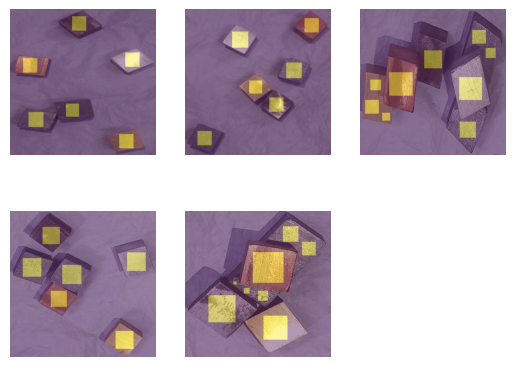

In [5]:
def visualize_dataset(images, labels):
    B = images.size(0)

    fig, axes = plt.subplots(B // 2, B - (B // 2))
    axes = axes.flatten()

    for ax in axes:
        ax.axis("off")
    
    for i in range(B):
        image = images[i].detach().cpu().numpy() # (3, H, W)
        label = labels[i].detach().cpu().numpy() # (H, W)

        if image.max() <= 1.0:
            image = (image * 255).astype(np.uint8)

        image = np.transpose(image, (1, 2, 0)) # (H, W, 3)
        label = np.transpose(label, (1, 2, 0))
        
        axes[i].imshow(image)
        axes[i].imshow(label, cmap="viridis", alpha=0.4)

    plt.show()
    
images, labels = next(iter(train_loader))
visualize_dataset(images, labels)

# Training

In [ ]:
device = 'cuda'
model = MetalSurface()
model.to(device)

MetalEdge(
  (enc1): CNNBlock(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (enc2): CNNBlock(
    (net): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (enc3): CNNBlock(
    (net): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), st

In [7]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)
criterion = metal_surface_loss()

# training parameters
num_epochs = 100

Epoch 1/100: 100%|██████████| 16/16 [00:02<00:00,  6.96it/s]


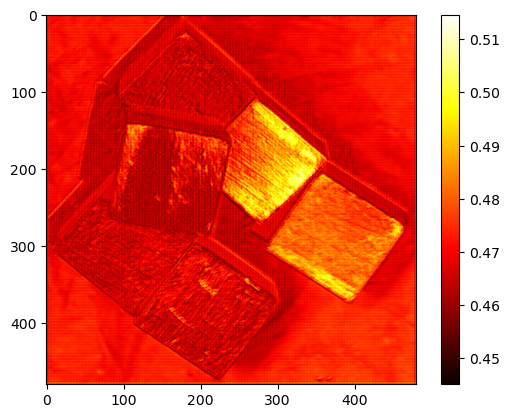

Epoch 1: Train Loss = 0.085981
Epoch 1: Val Loss = 0.098695


Epoch 2/100: 100%|██████████| 16/16 [00:01<00:00,  8.13it/s]


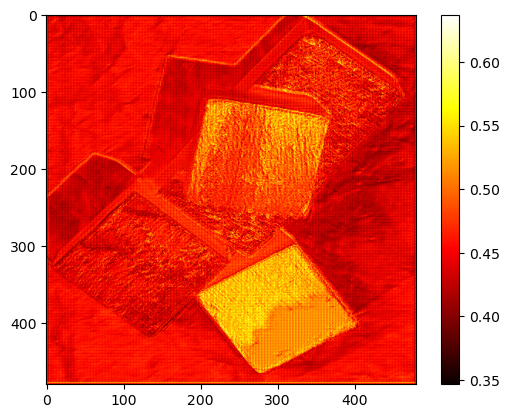

Epoch 2: Train Loss = 0.079220
Epoch 2: Val Loss = 0.082630


Epoch 3/100: 100%|██████████| 16/16 [00:01<00:00,  8.14it/s]


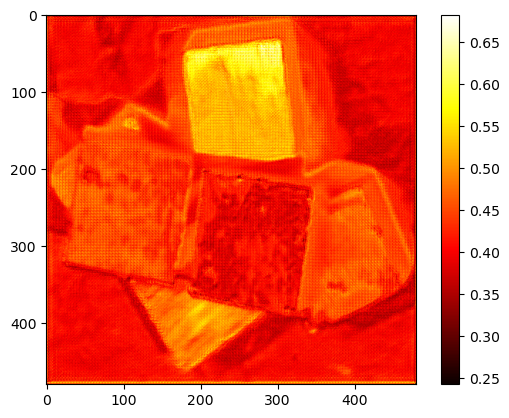

Epoch 3: Train Loss = 0.074659
Epoch 3: Val Loss = 0.073865


Epoch 4/100: 100%|██████████| 16/16 [00:01<00:00,  8.13it/s]


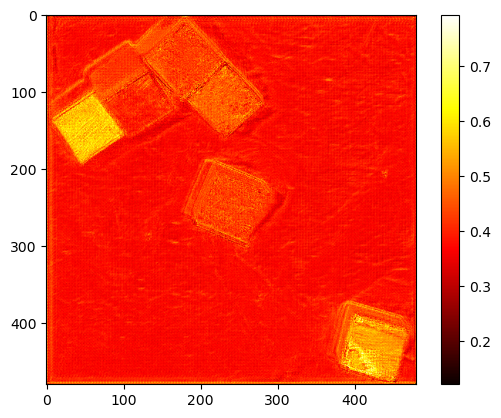

Epoch 4: Train Loss = 0.071432
Epoch 4: Val Loss = 0.068768


Epoch 5/100: 100%|██████████| 16/16 [00:01<00:00,  8.15it/s]


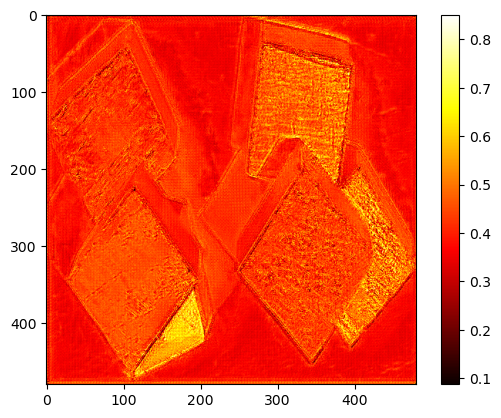

Epoch 5: Train Loss = 0.068697
Epoch 5: Val Loss = 0.065197


Epoch 6/100: 100%|██████████| 16/16 [00:01<00:00,  8.14it/s]


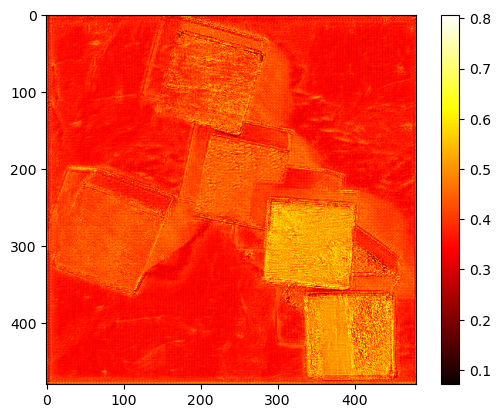

Epoch 6: Train Loss = 0.066349
Epoch 6: Val Loss = 0.062815


Epoch 7/100: 100%|██████████| 16/16 [00:01<00:00,  8.13it/s]


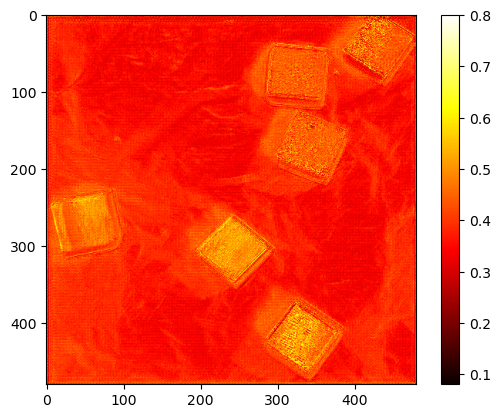

Epoch 7: Train Loss = 0.064085
Epoch 7: Val Loss = 0.060754


Epoch 8/100: 100%|██████████| 16/16 [00:01<00:00,  8.12it/s]


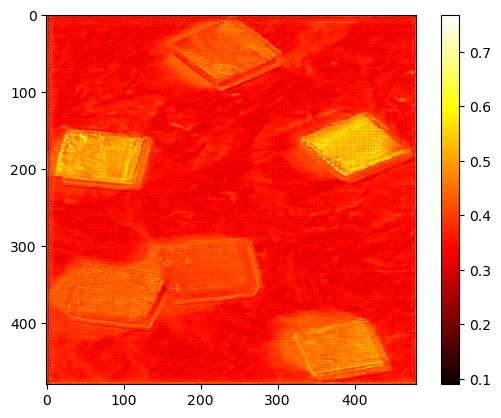

Epoch 8: Train Loss = 0.061817
Epoch 8: Val Loss = 0.058539


Epoch 9/100: 100%|██████████| 16/16 [00:01<00:00,  8.14it/s]


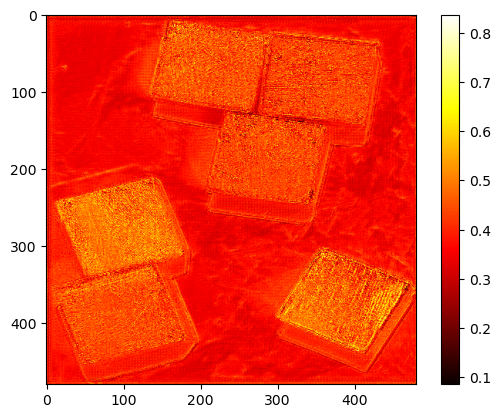

Epoch 9: Train Loss = 0.060133
Epoch 9: Val Loss = 0.056609


Epoch 10/100: 100%|██████████| 16/16 [00:01<00:00,  8.13it/s]


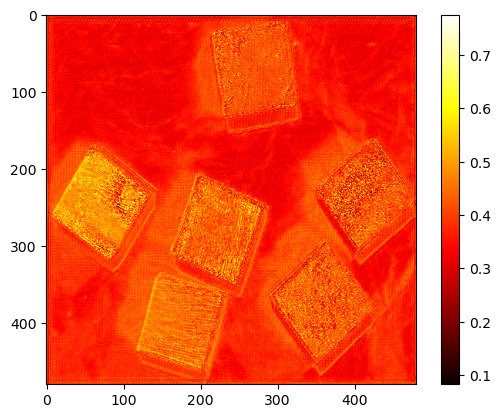

Epoch 10: Train Loss = 0.058630
Epoch 10: Val Loss = 0.055573


Epoch 11/100: 100%|██████████| 16/16 [00:01<00:00,  8.15it/s]


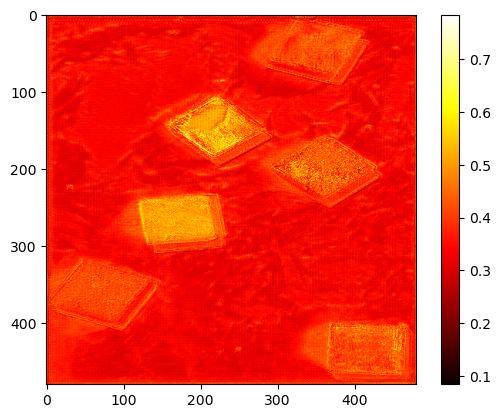

Epoch 11: Train Loss = 0.057080
Epoch 11: Val Loss = 0.054192


Epoch 12/100: 100%|██████████| 16/16 [00:01<00:00,  8.12it/s]


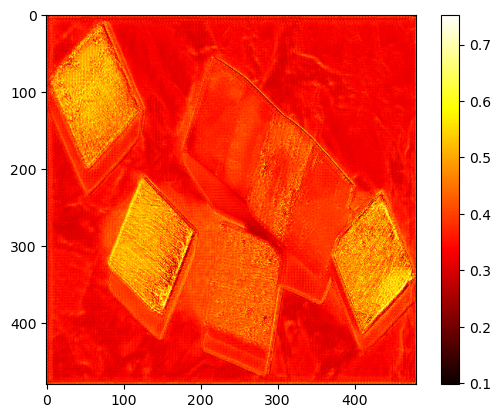

Epoch 12: Train Loss = 0.055792
Epoch 12: Val Loss = 0.052397


Epoch 13/100: 100%|██████████| 16/16 [00:01<00:00,  8.13it/s]


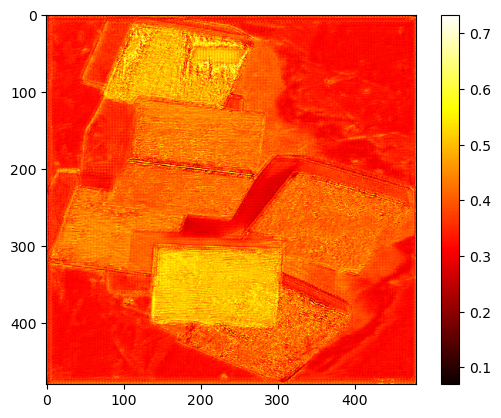

Epoch 13: Train Loss = 0.054429
Epoch 13: Val Loss = 0.051352


Epoch 14/100: 100%|██████████| 16/16 [00:01<00:00,  8.11it/s]


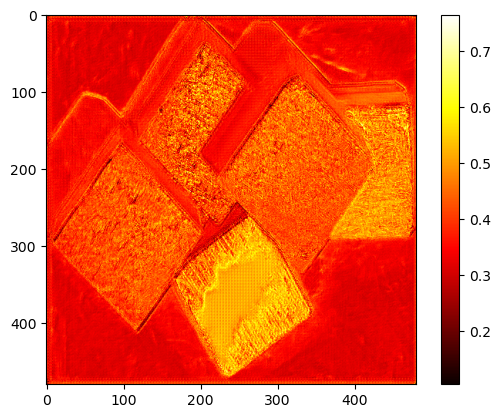

Epoch 14: Train Loss = 0.053168
Epoch 14: Val Loss = 0.050118


Epoch 15/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


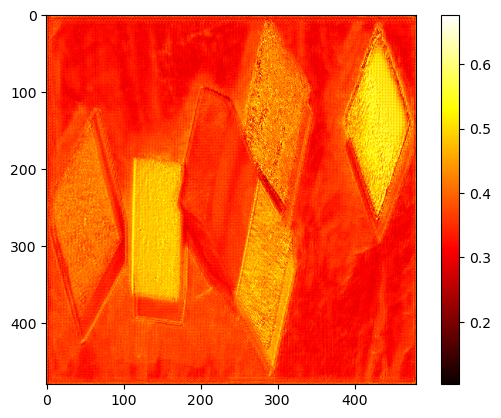

Epoch 15: Train Loss = 0.052162
Epoch 15: Val Loss = 0.049525


Epoch 16/100: 100%|██████████| 16/16 [00:02<00:00,  7.60it/s]


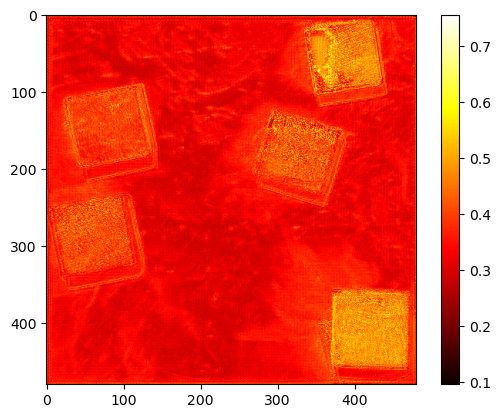

Epoch 16: Train Loss = 0.050974
Epoch 16: Val Loss = 0.047586


Epoch 17/100: 100%|██████████| 16/16 [00:02<00:00,  7.66it/s]


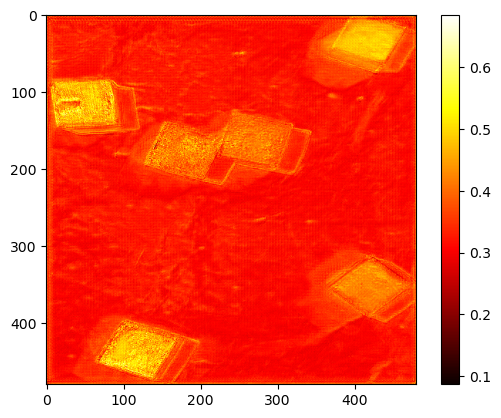

Epoch 17: Train Loss = 0.049783
Epoch 17: Val Loss = 0.047034


Epoch 18/100: 100%|██████████| 16/16 [00:02<00:00,  7.78it/s]


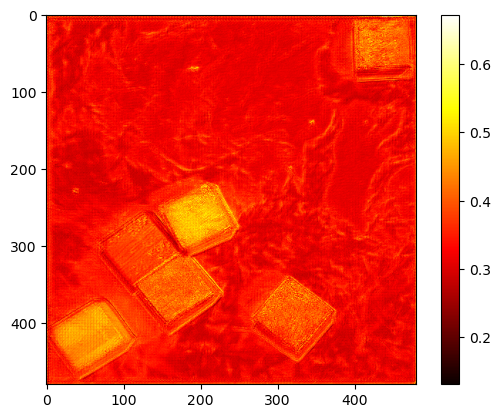

Epoch 18: Train Loss = 0.048594
Epoch 18: Val Loss = 0.045761


Epoch 19/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


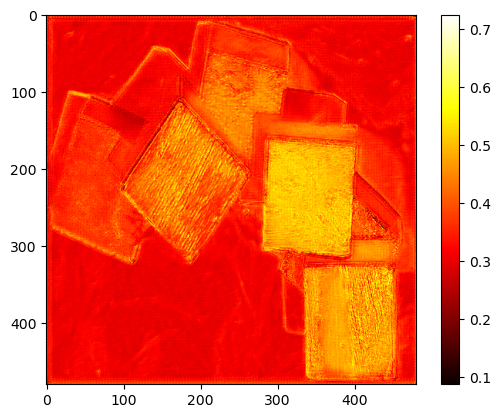

Epoch 19: Train Loss = 0.047687
Epoch 19: Val Loss = 0.044899


Epoch 20/100: 100%|██████████| 16/16 [00:02<00:00,  7.99it/s]


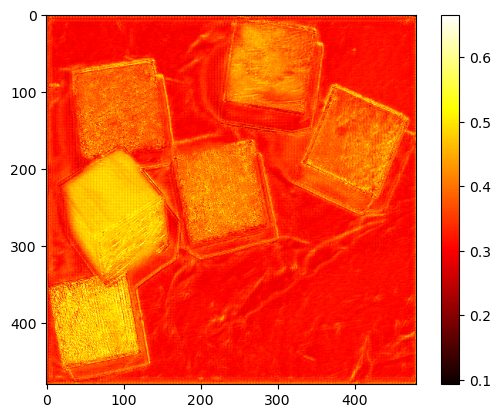

Epoch 20: Train Loss = 0.046727
Epoch 20: Val Loss = 0.044125


Epoch 21/100: 100%|██████████| 16/16 [00:02<00:00,  7.96it/s]


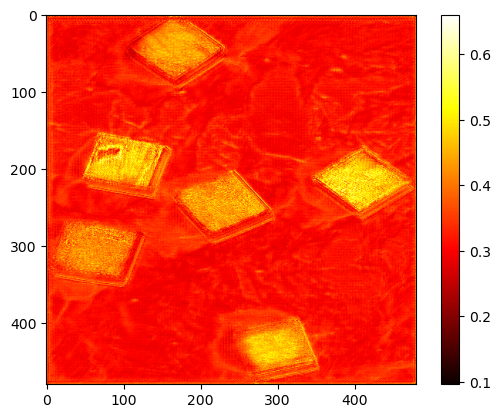

Epoch 21: Train Loss = 0.045823
Epoch 21: Val Loss = 0.042893


Epoch 22/100: 100%|██████████| 16/16 [00:02<00:00,  7.78it/s]


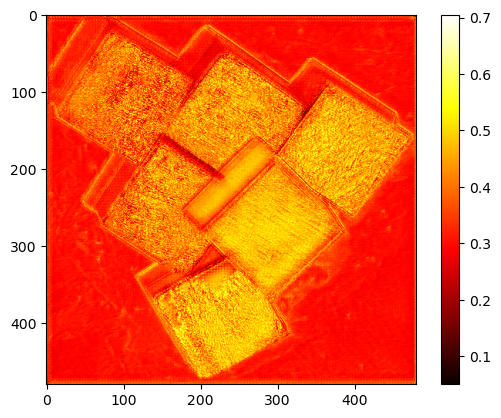

Epoch 22: Train Loss = 0.044802
Epoch 22: Val Loss = 0.042221


Epoch 23/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


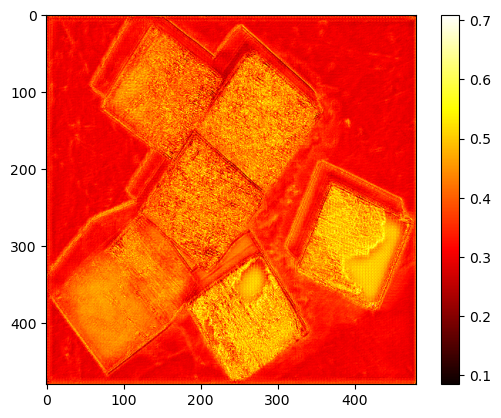

Epoch 23: Train Loss = 0.043995
Epoch 23: Val Loss = 0.042030


Epoch 24/100: 100%|██████████| 16/16 [00:02<00:00,  7.92it/s]


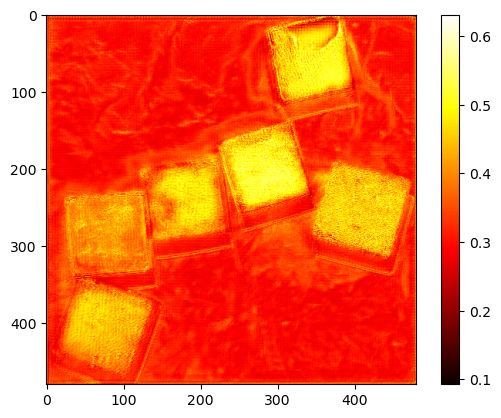

Epoch 24: Train Loss = 0.043446
Epoch 24: Val Loss = 0.040161


Epoch 25/100: 100%|██████████| 16/16 [00:02<00:00,  7.77it/s]


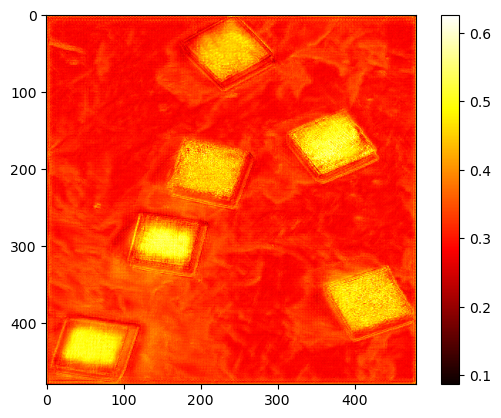

Epoch 25: Train Loss = 0.042256
Epoch 25: Val Loss = 0.040507


Epoch 26/100: 100%|██████████| 16/16 [00:02<00:00,  7.72it/s]


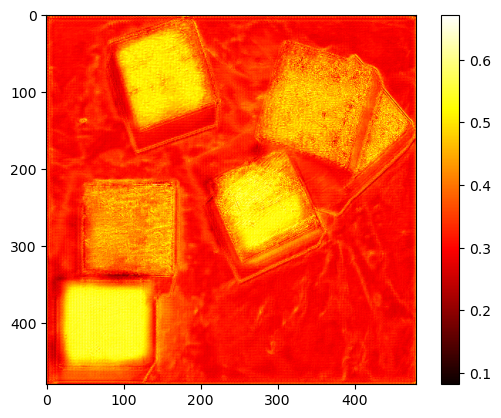

Epoch 26: Train Loss = 0.041845
Epoch 26: Val Loss = 0.040372


Epoch 27/100: 100%|██████████| 16/16 [00:02<00:00,  7.89it/s]


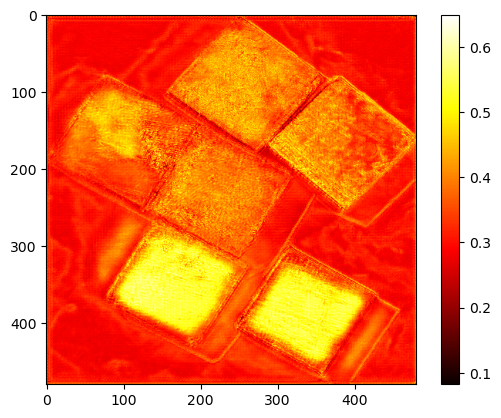

Epoch 27: Train Loss = 0.041104
Epoch 27: Val Loss = 0.038735


Epoch 28/100: 100%|██████████| 16/16 [00:02<00:00,  7.77it/s]


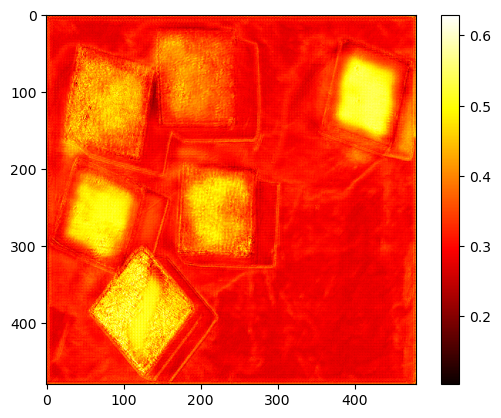

Epoch 28: Train Loss = 0.040232
Epoch 28: Val Loss = 0.037868


Epoch 29/100: 100%|██████████| 16/16 [00:02<00:00,  7.09it/s]


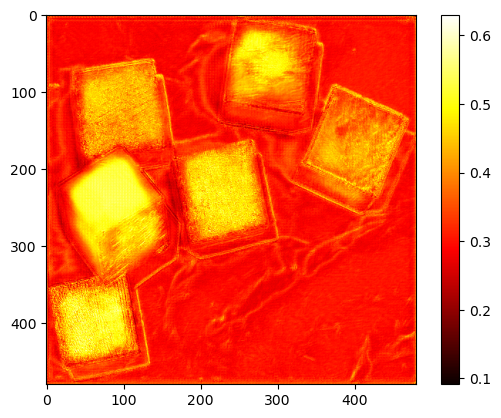

Epoch 29: Train Loss = 0.039795
Epoch 29: Val Loss = 0.037264


Epoch 30/100: 100%|██████████| 16/16 [00:02<00:00,  7.53it/s]


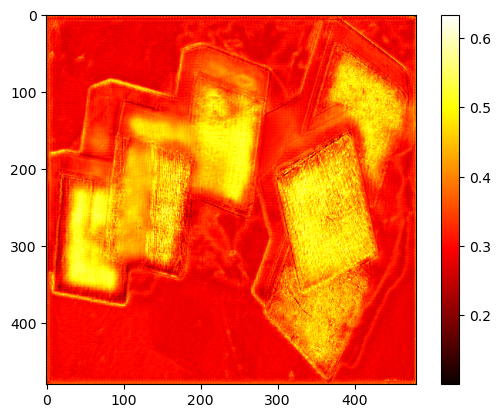

Epoch 30: Train Loss = 0.039226
Epoch 30: Val Loss = 0.036029


Epoch 31/100: 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]


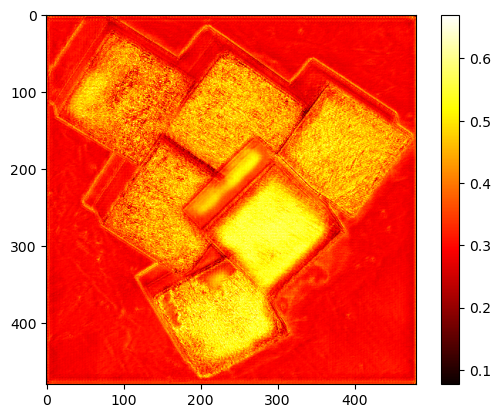

Epoch 31: Train Loss = 0.038697
Epoch 31: Val Loss = 0.036636


Epoch 32/100: 100%|██████████| 16/16 [00:02<00:00,  7.64it/s]


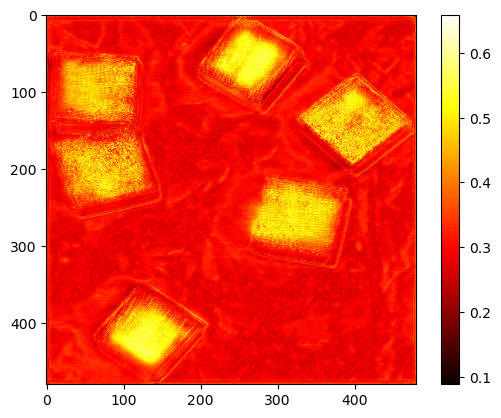

Epoch 32: Train Loss = 0.038093
Epoch 32: Val Loss = 0.036001


Epoch 33/100: 100%|██████████| 16/16 [00:02<00:00,  7.90it/s]


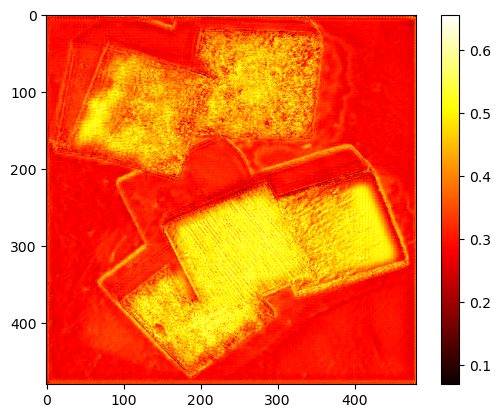

Epoch 33: Train Loss = 0.037509
Epoch 33: Val Loss = 0.035595


Epoch 34/100: 100%|██████████| 16/16 [00:02<00:00,  7.87it/s]


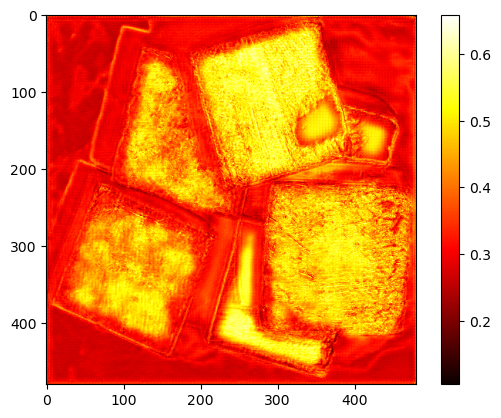

Epoch 34: Train Loss = 0.037259
Epoch 34: Val Loss = 0.035296


Epoch 35/100: 100%|██████████| 16/16 [00:02<00:00,  7.92it/s]


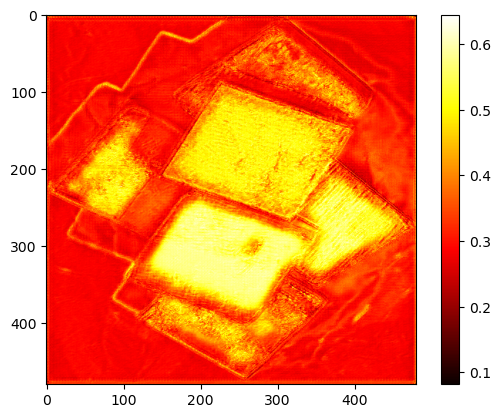

Epoch 35: Train Loss = 0.036696
Epoch 35: Val Loss = 0.034821


Epoch 36/100: 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]


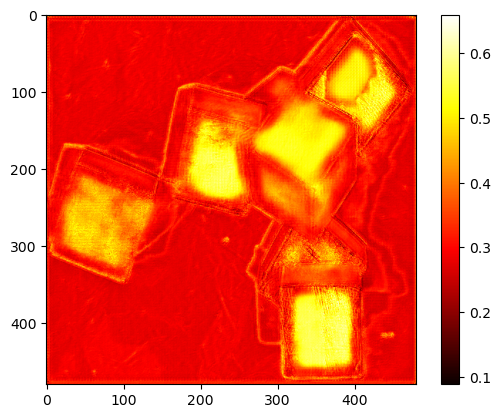

Epoch 36: Train Loss = 0.035989
Epoch 36: Val Loss = 0.033788


Epoch 37/100: 100%|██████████| 16/16 [00:02<00:00,  7.72it/s]


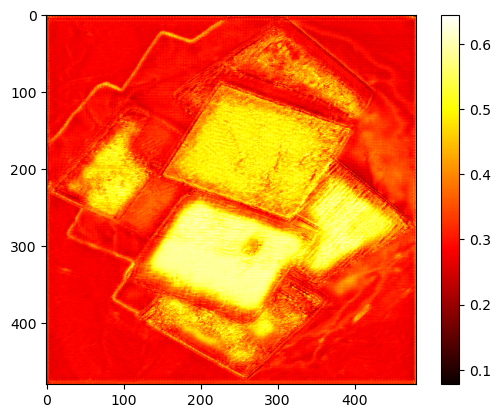

Epoch 37: Train Loss = 0.035632
Epoch 37: Val Loss = 0.033785


Epoch 38/100: 100%|██████████| 16/16 [00:02<00:00,  7.84it/s]


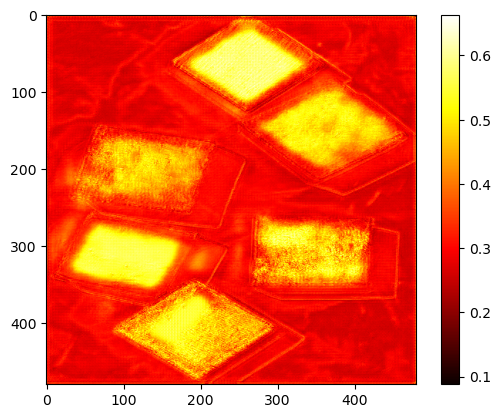

Epoch 38: Train Loss = 0.035228
Epoch 38: Val Loss = 0.034313


Epoch 39/100: 100%|██████████| 16/16 [00:02<00:00,  7.84it/s]


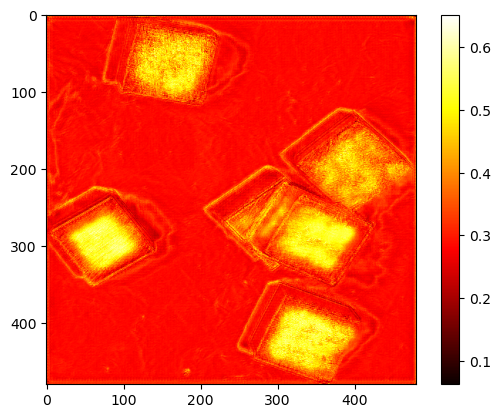

Epoch 39: Train Loss = 0.034770
Epoch 39: Val Loss = 0.033282


Epoch 40/100: 100%|██████████| 16/16 [00:02<00:00,  7.87it/s]


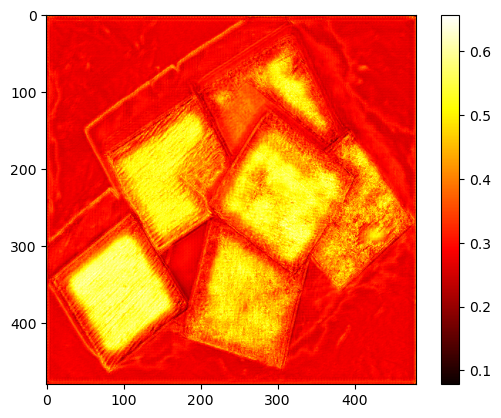

Epoch 40: Train Loss = 0.034559
Epoch 40: Val Loss = 0.033715


Epoch 41/100: 100%|██████████| 16/16 [00:02<00:00,  7.92it/s]


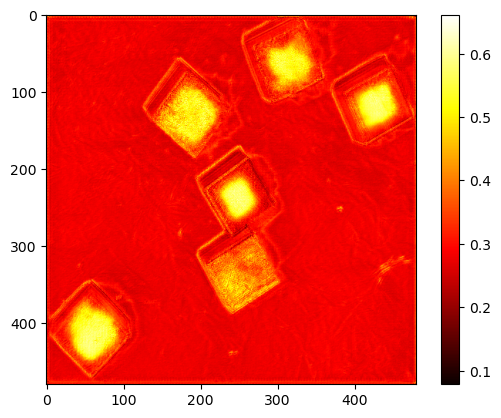

Epoch 41: Train Loss = 0.034102
Epoch 41: Val Loss = 0.033338


Epoch 42/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


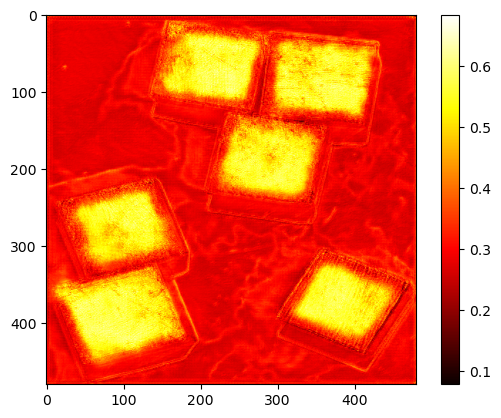

Epoch 42: Train Loss = 0.033863
Epoch 42: Val Loss = 0.032584


Epoch 43/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


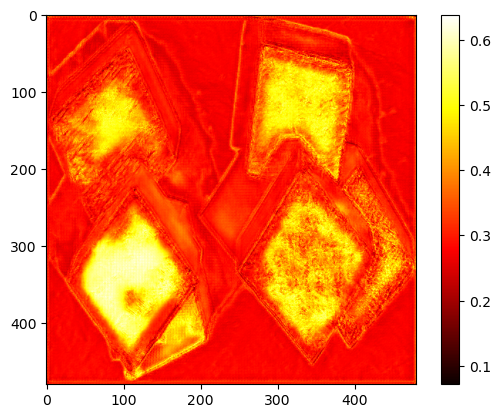

Epoch 43: Train Loss = 0.033683
Epoch 43: Val Loss = 0.032453


Epoch 44/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


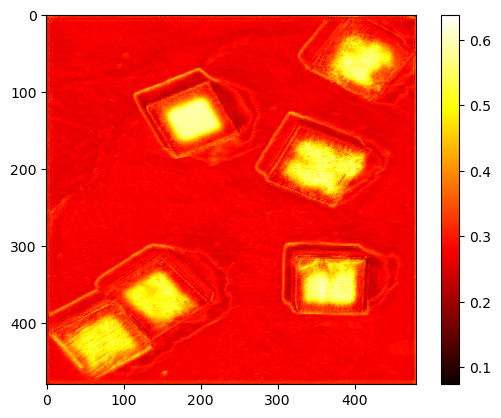

Epoch 44: Train Loss = 0.033081
Epoch 44: Val Loss = 0.031135


Epoch 45/100: 100%|██████████| 16/16 [00:02<00:00,  7.84it/s]


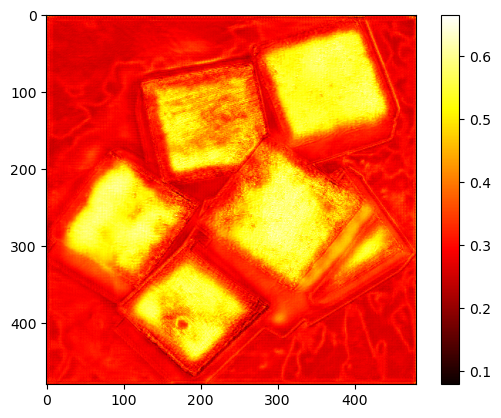

Epoch 45: Train Loss = 0.032803
Epoch 45: Val Loss = 0.031805


Epoch 46/100: 100%|██████████| 16/16 [00:02<00:00,  7.96it/s]


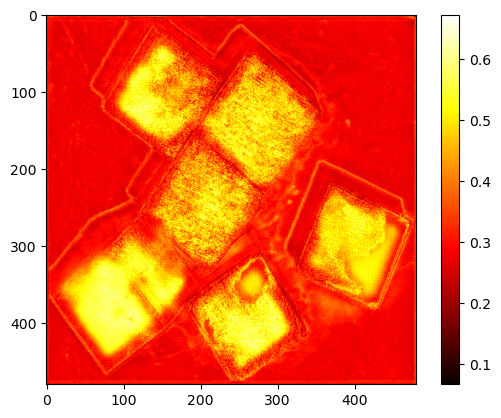

Epoch 46: Train Loss = 0.032445
Epoch 46: Val Loss = 0.031383


Epoch 47/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


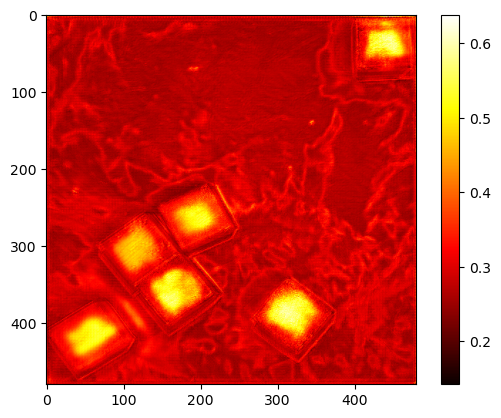

Epoch 47: Train Loss = 0.032070
Epoch 47: Val Loss = 0.030442


Epoch 48/100: 100%|██████████| 16/16 [00:02<00:00,  7.86it/s]


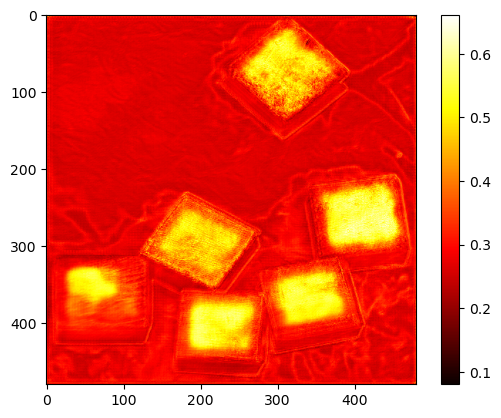

Epoch 48: Train Loss = 0.031913
Epoch 48: Val Loss = 0.030215


Epoch 49/100: 100%|██████████| 16/16 [00:02<00:00,  7.84it/s]


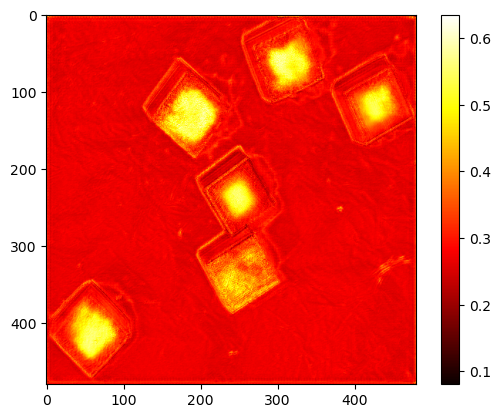

Epoch 49: Train Loss = 0.031779
Epoch 49: Val Loss = 0.030169


Epoch 50/100: 100%|██████████| 16/16 [00:02<00:00,  7.85it/s]


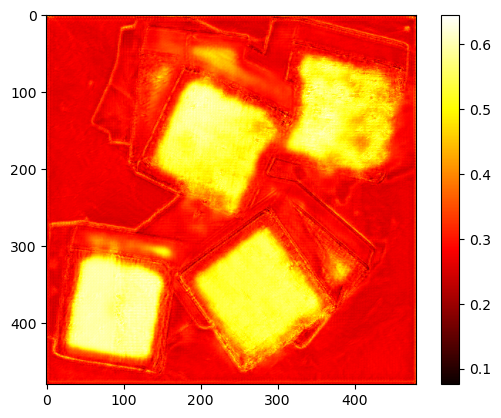

Epoch 50: Train Loss = 0.031493
Epoch 50: Val Loss = 0.030699


Epoch 51/100: 100%|██████████| 16/16 [00:02<00:00,  7.79it/s]


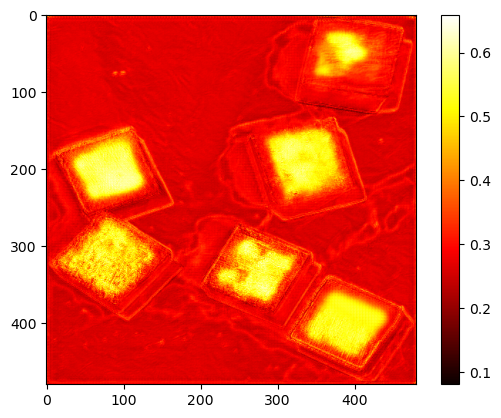

Epoch 51: Train Loss = 0.031155
Epoch 51: Val Loss = 0.029585


Epoch 52/100: 100%|██████████| 16/16 [00:02<00:00,  7.90it/s]


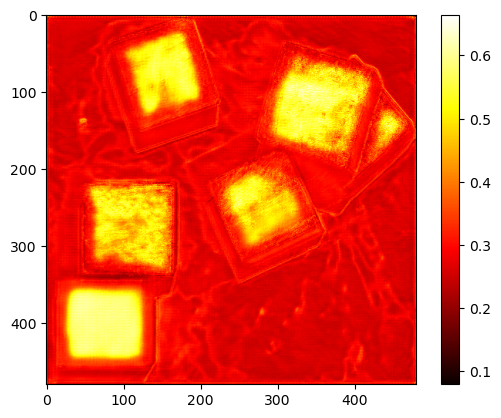

Epoch 52: Train Loss = 0.031052
Epoch 52: Val Loss = 0.029111


Epoch 53/100: 100%|██████████| 16/16 [00:02<00:00,  7.94it/s]


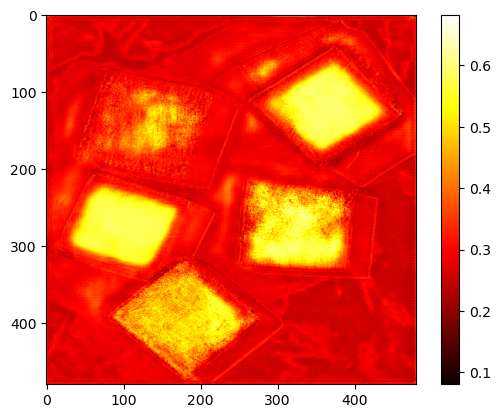

Epoch 53: Train Loss = 0.030814
Epoch 53: Val Loss = 0.029537


Epoch 54/100: 100%|██████████| 16/16 [00:02<00:00,  7.89it/s]


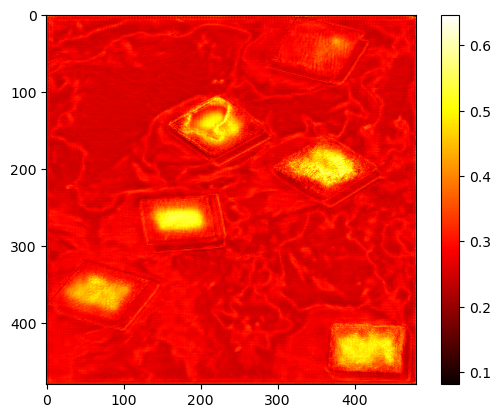

Epoch 54: Train Loss = 0.030614
Epoch 54: Val Loss = 0.028663


Epoch 55/100: 100%|██████████| 16/16 [00:02<00:00,  7.96it/s]


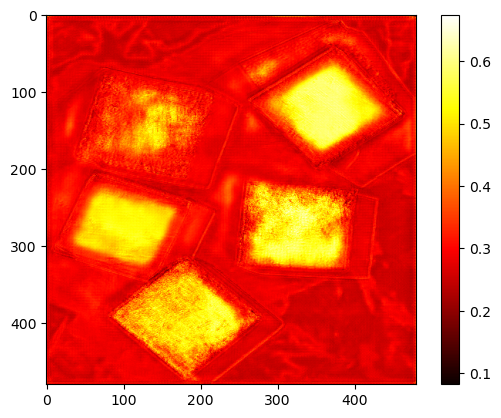

Epoch 55: Train Loss = 0.030287
Epoch 55: Val Loss = 0.028509


Epoch 56/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


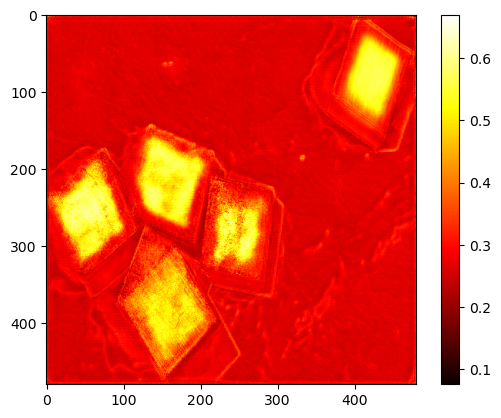

Epoch 56: Train Loss = 0.029953
Epoch 56: Val Loss = 0.028508


Epoch 57/100: 100%|██████████| 16/16 [00:02<00:00,  7.94it/s]


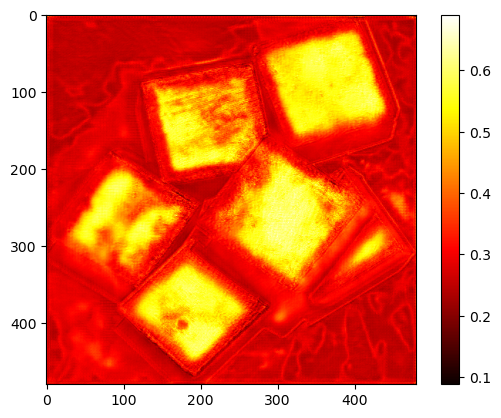

Epoch 57: Train Loss = 0.030018
Epoch 57: Val Loss = 0.028579


Epoch 58/100: 100%|██████████| 16/16 [00:02<00:00,  7.87it/s]


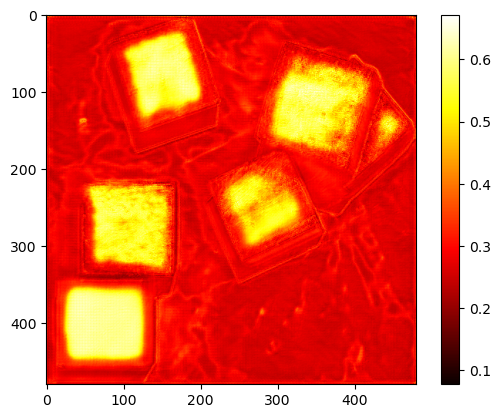

Epoch 58: Train Loss = 0.029704
Epoch 58: Val Loss = 0.028392


Epoch 59/100: 100%|██████████| 16/16 [00:02<00:00,  7.91it/s]


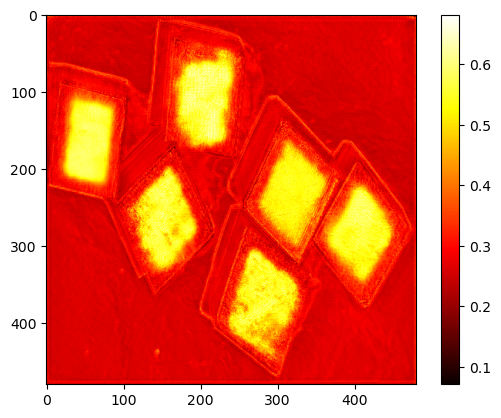

Epoch 59: Train Loss = 0.029456
Epoch 59: Val Loss = 0.028001


Epoch 60/100: 100%|██████████| 16/16 [00:02<00:00,  7.90it/s]


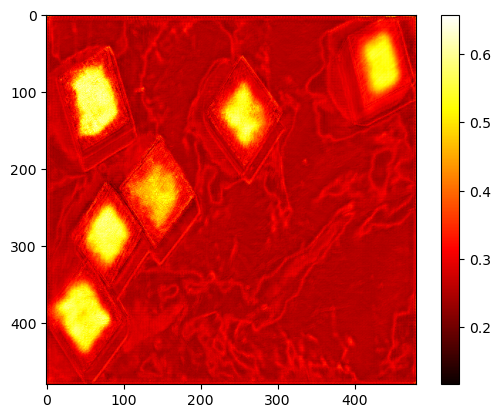

Epoch 60: Train Loss = 0.029365
Epoch 60: Val Loss = 0.027432


Epoch 61/100: 100%|██████████| 16/16 [00:02<00:00,  7.75it/s]


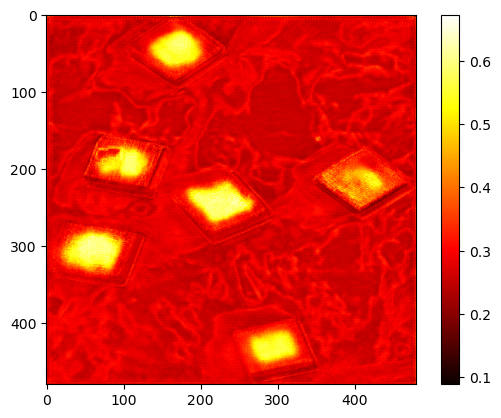

Epoch 61: Train Loss = 0.029312
Epoch 61: Val Loss = 0.028020


Epoch 62/100: 100%|██████████| 16/16 [00:02<00:00,  7.67it/s]


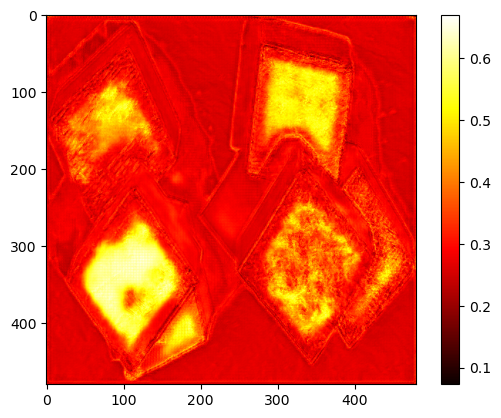

Epoch 62: Train Loss = 0.028896
Epoch 62: Val Loss = 0.028124


Epoch 63/100: 100%|██████████| 16/16 [00:02<00:00,  7.47it/s]


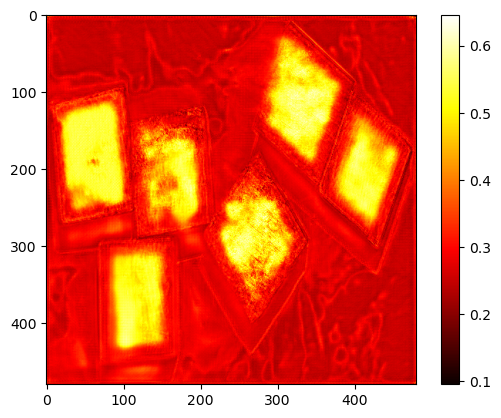

Epoch 63: Train Loss = 0.029005
Epoch 63: Val Loss = 0.027409


Epoch 64/100: 100%|██████████| 16/16 [00:02<00:00,  7.77it/s]


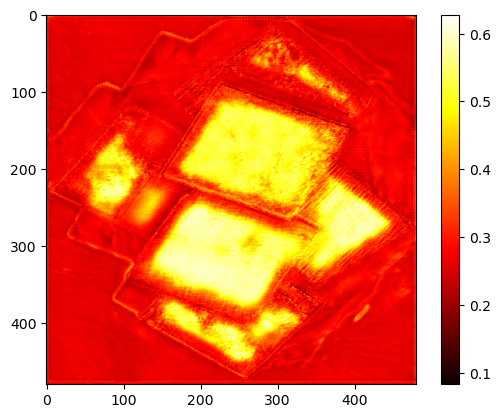

Epoch 64: Train Loss = 0.028419
Epoch 64: Val Loss = 0.027444


Epoch 65/100: 100%|██████████| 16/16 [00:02<00:00,  7.87it/s]


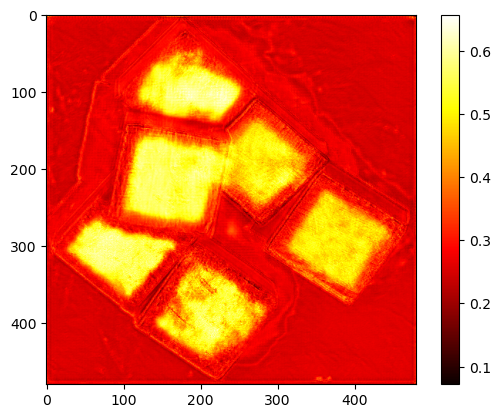

Epoch 65: Train Loss = 0.028292
Epoch 65: Val Loss = 0.027023


Epoch 66/100: 100%|██████████| 16/16 [00:02<00:00,  7.64it/s]


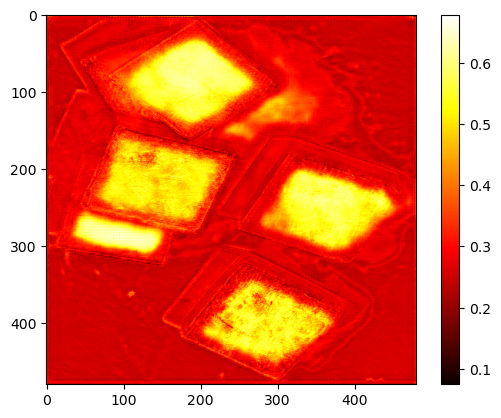

Epoch 66: Train Loss = 0.028434
Epoch 66: Val Loss = 0.027872


Epoch 67/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


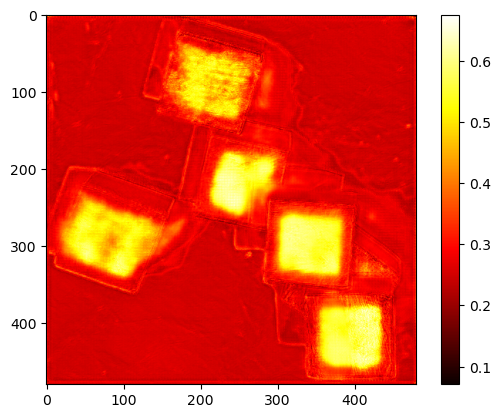

Epoch 67: Train Loss = 0.028364
Epoch 67: Val Loss = 0.026741


Epoch 68/100: 100%|██████████| 16/16 [00:02<00:00,  7.91it/s]


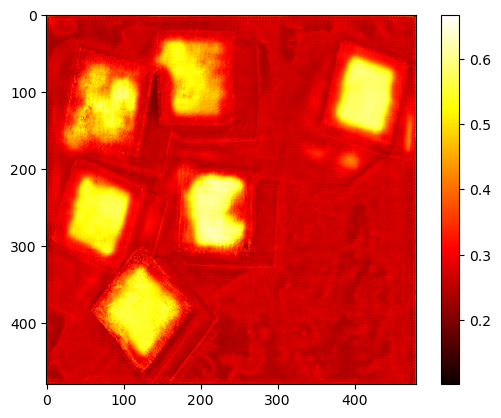

Epoch 68: Train Loss = 0.027788
Epoch 68: Val Loss = 0.026589


Epoch 69/100: 100%|██████████| 16/16 [00:02<00:00,  7.93it/s]


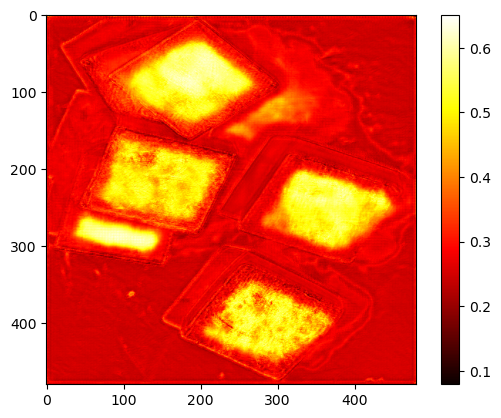

Epoch 69: Train Loss = 0.027929
Epoch 69: Val Loss = 0.026391


Epoch 70/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


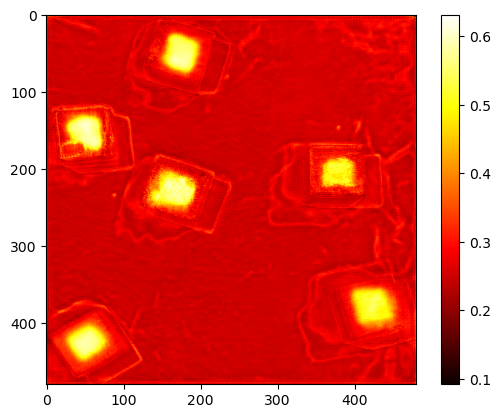

Epoch 70: Train Loss = 0.027768
Epoch 70: Val Loss = 0.026732


Epoch 71/100: 100%|██████████| 16/16 [00:01<00:00,  8.02it/s]


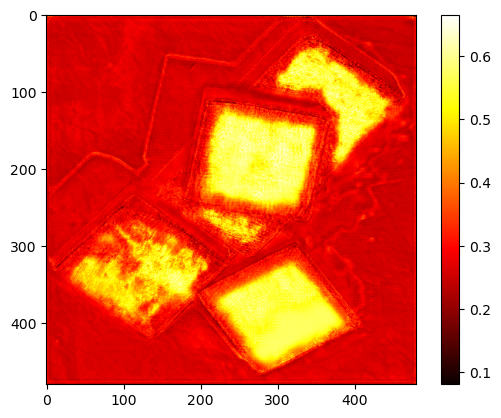

Epoch 71: Train Loss = 0.027808
Epoch 71: Val Loss = 0.026793


Epoch 72/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


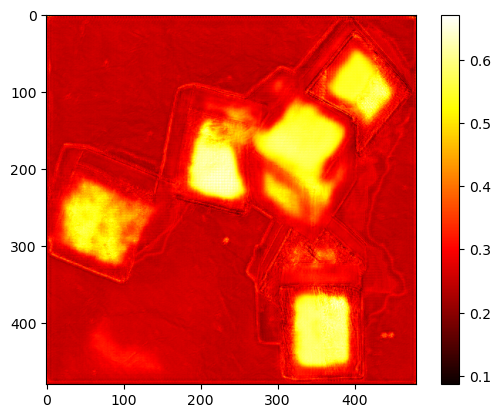

Epoch 72: Train Loss = 0.027347
Epoch 72: Val Loss = 0.026051


Epoch 73/100: 100%|██████████| 16/16 [00:01<00:00,  8.00it/s]


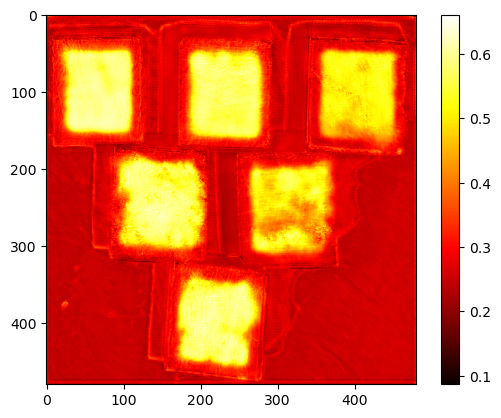

Epoch 73: Train Loss = 0.027348
Epoch 73: Val Loss = 0.026159


Epoch 74/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


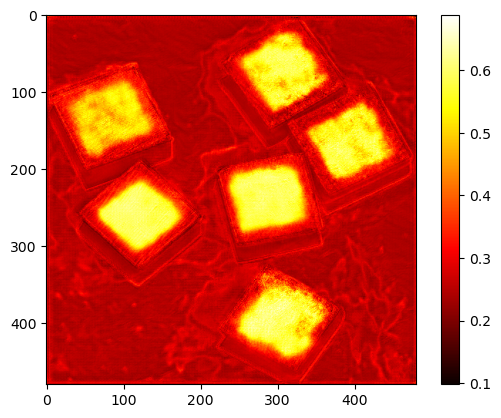

Epoch 74: Train Loss = 0.027041
Epoch 74: Val Loss = 0.025694


Epoch 75/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


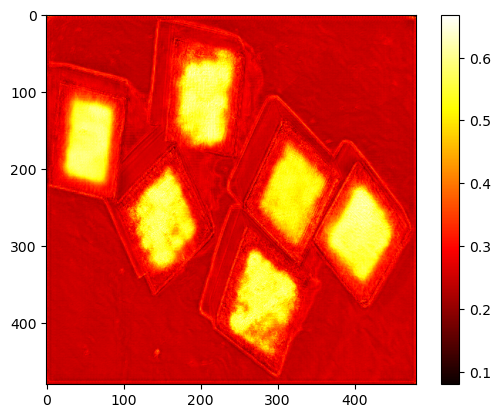

Epoch 75: Train Loss = 0.026825
Epoch 75: Val Loss = 0.025414


Epoch 76/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


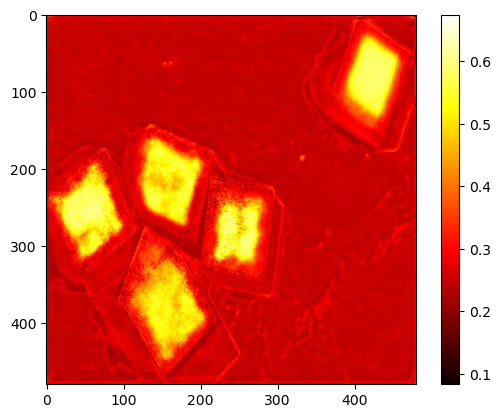

Epoch 76: Train Loss = 0.026928
Epoch 76: Val Loss = 0.025655


Epoch 77/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


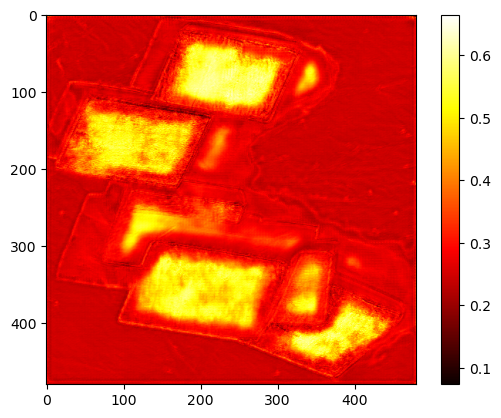

Epoch 77: Train Loss = 0.026677
Epoch 77: Val Loss = 0.026059


Epoch 78/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


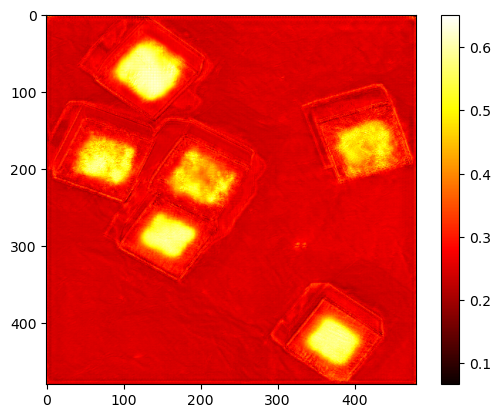

Epoch 78: Train Loss = 0.026507
Epoch 78: Val Loss = 0.025259


Epoch 79/100: 100%|██████████| 16/16 [00:02<00:00,  7.99it/s]


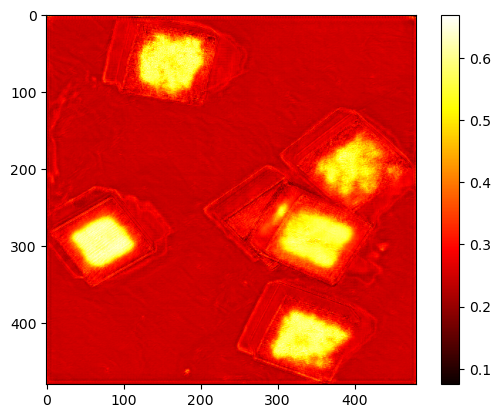

Epoch 79: Train Loss = 0.026384
Epoch 79: Val Loss = 0.025319


Epoch 80/100: 100%|██████████| 16/16 [00:02<00:00,  7.99it/s]


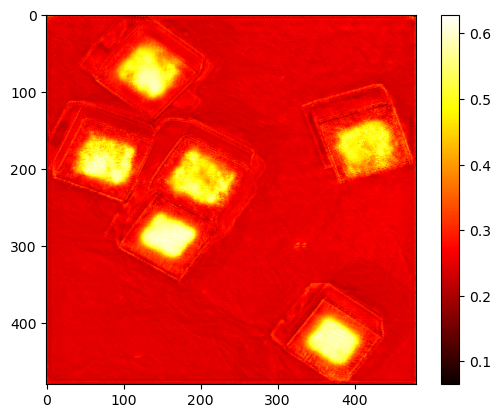

Epoch 80: Train Loss = 0.026197
Epoch 80: Val Loss = 0.024921


Epoch 81/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


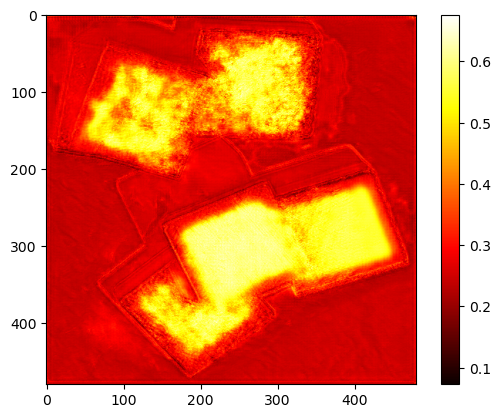

Epoch 81: Train Loss = 0.026075
Epoch 81: Val Loss = 0.025053


Epoch 82/100: 100%|██████████| 16/16 [00:01<00:00,  8.00it/s]


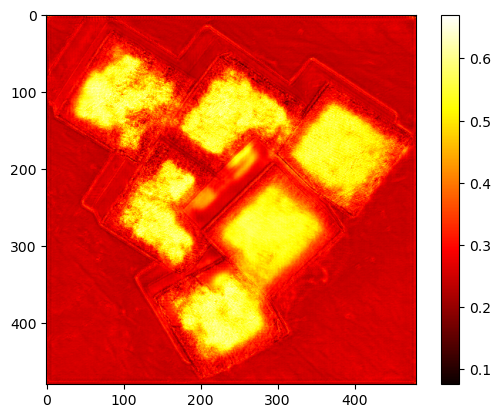

Epoch 82: Train Loss = 0.025961
Epoch 82: Val Loss = 0.025555


Epoch 83/100: 100%|██████████| 16/16 [00:01<00:00,  8.00it/s]


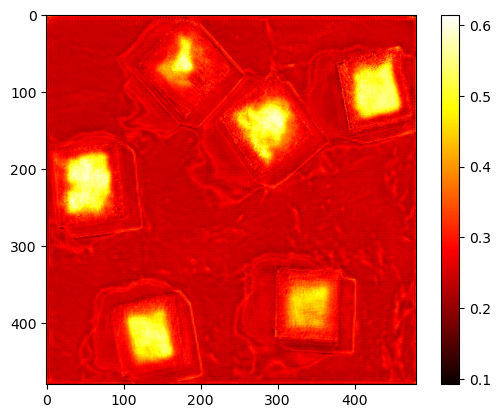

Epoch 83: Train Loss = 0.025894
Epoch 83: Val Loss = 0.024679


Epoch 84/100: 100%|██████████| 16/16 [00:01<00:00,  8.02it/s]


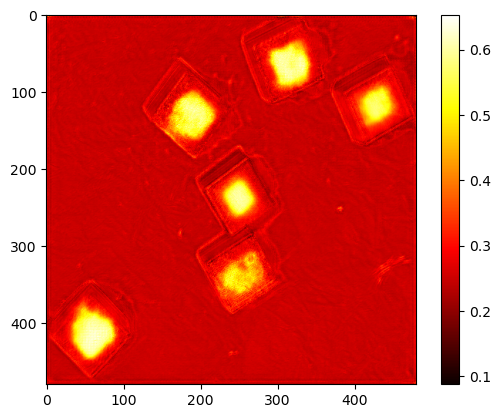

Epoch 84: Train Loss = 0.026081
Epoch 84: Val Loss = 0.025494


Epoch 85/100: 100%|██████████| 16/16 [00:02<00:00,  8.00it/s]


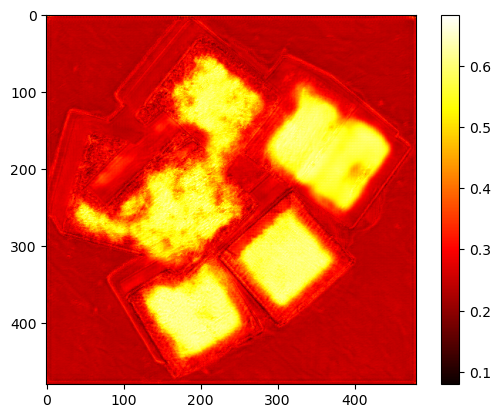

Epoch 85: Train Loss = 0.025869
Epoch 85: Val Loss = 0.025424


Epoch 86/100: 100%|██████████| 16/16 [00:01<00:00,  8.02it/s]


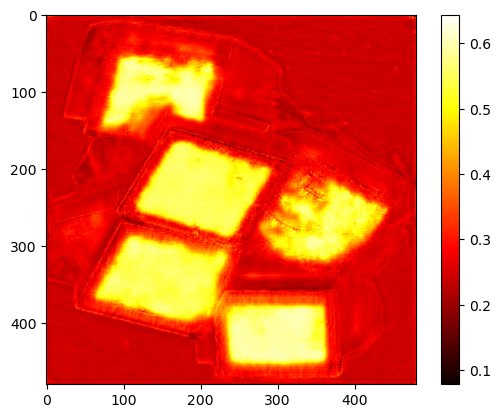

Epoch 86: Train Loss = 0.025503
Epoch 86: Val Loss = 0.024600


Epoch 87/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


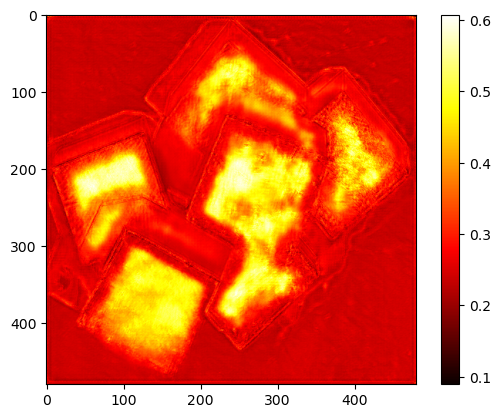

Epoch 87: Train Loss = 0.025513
Epoch 87: Val Loss = 0.024527


Epoch 88/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


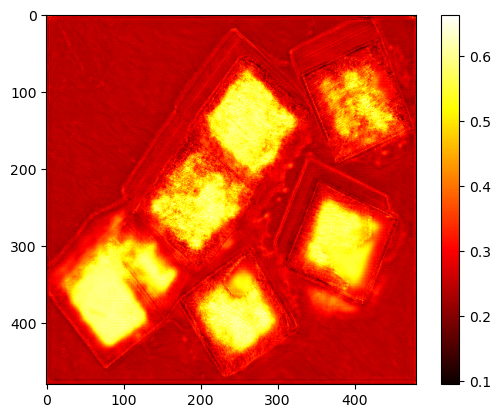

Epoch 88: Train Loss = 0.025626
Epoch 88: Val Loss = 0.024556


Epoch 89/100: 100%|██████████| 16/16 [00:02<00:00,  7.88it/s]


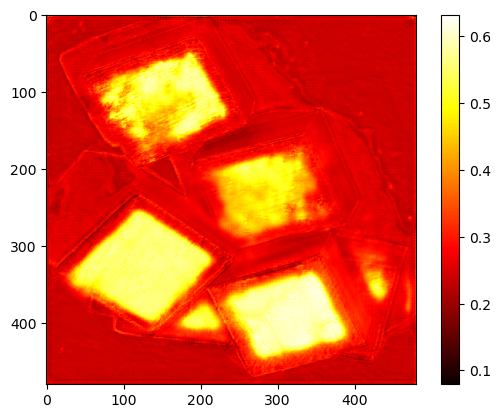

Epoch 89: Train Loss = 0.025288
Epoch 89: Val Loss = 0.024655


Epoch 90/100: 100%|██████████| 16/16 [00:01<00:00,  8.03it/s]


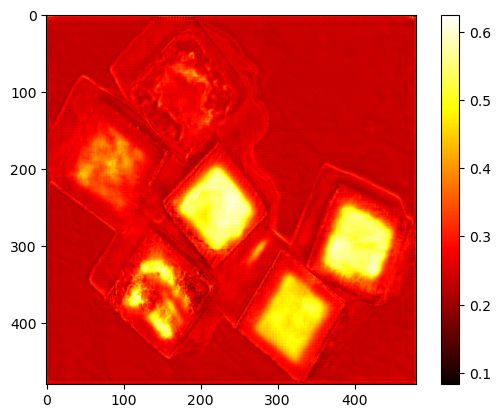

Epoch 90: Train Loss = 0.025302
Epoch 90: Val Loss = 0.023743


Epoch 91/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


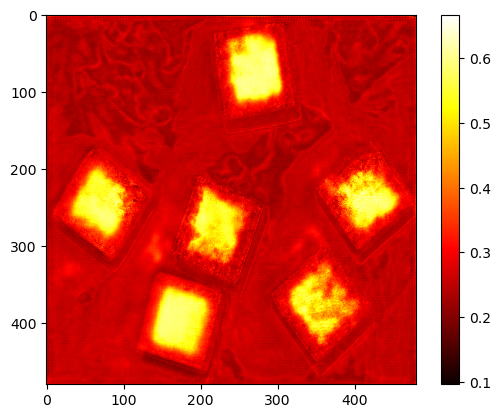

Epoch 91: Train Loss = 0.025032
Epoch 91: Val Loss = 0.024574


Epoch 92/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


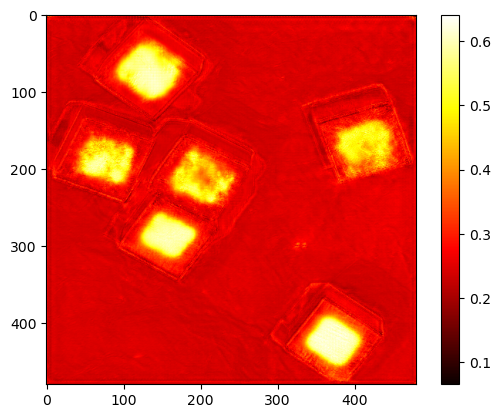

Epoch 92: Train Loss = 0.025140
Epoch 92: Val Loss = 0.023967


Epoch 93/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


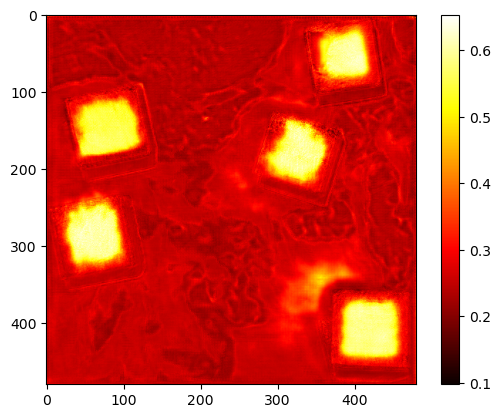

Epoch 93: Train Loss = 0.024828
Epoch 93: Val Loss = 0.024301


Epoch 94/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


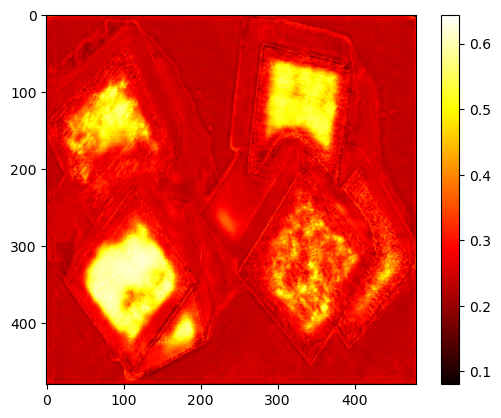

Epoch 94: Train Loss = 0.024784
Epoch 94: Val Loss = 0.023720


Epoch 95/100: 100%|██████████| 16/16 [00:02<00:00,  7.99it/s]


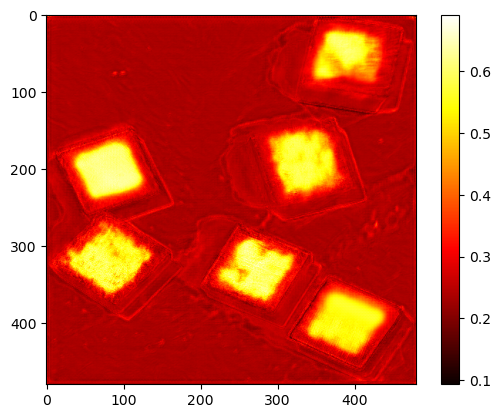

Epoch 95: Train Loss = 0.024652
Epoch 95: Val Loss = 0.024257


Epoch 96/100: 100%|██████████| 16/16 [00:02<00:00,  8.00it/s]


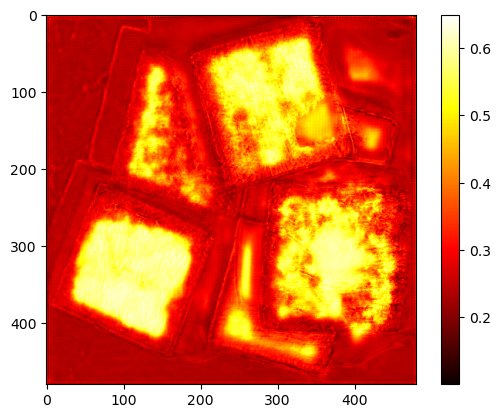

Epoch 96: Train Loss = 0.024761
Epoch 96: Val Loss = 0.023927


Epoch 97/100: 100%|██████████| 16/16 [00:02<00:00,  7.99it/s]


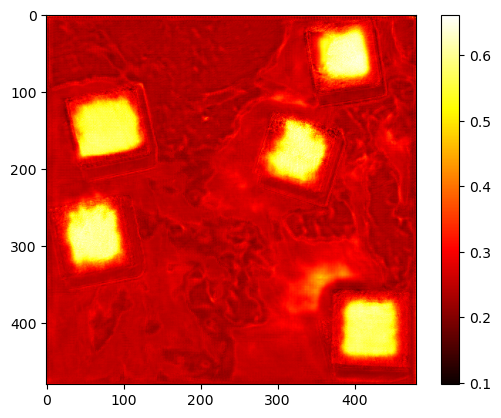

Epoch 97: Train Loss = 0.024364
Epoch 97: Val Loss = 0.023950


Epoch 98/100: 100%|██████████| 16/16 [00:02<00:00,  7.97it/s]


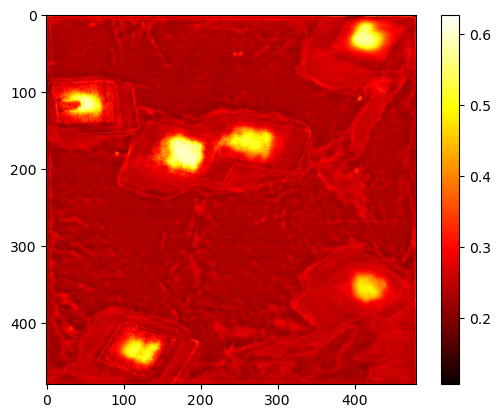

Epoch 98: Train Loss = 0.024366
Epoch 98: Val Loss = 0.023327


Epoch 99/100: 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]


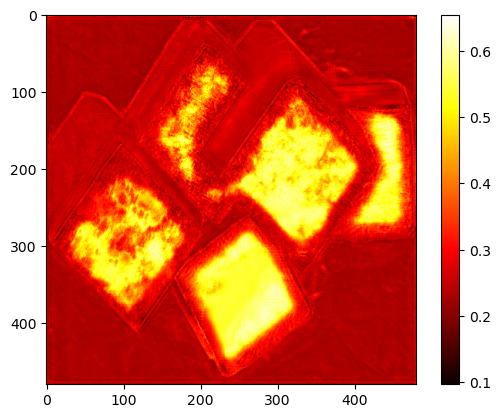

Epoch 99: Train Loss = 0.024388
Epoch 99: Val Loss = 0.023066


Epoch 100/100: 100%|██████████| 16/16 [00:01<00:00,  8.01it/s]


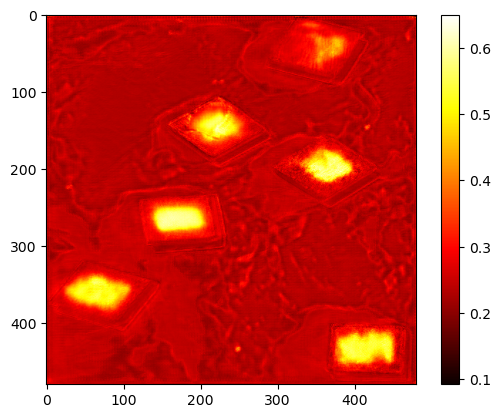

Epoch 100: Train Loss = 0.024232
Epoch 100: Val Loss = 0.023541


In [8]:
scaler = torch.amp.GradScaler(device) # <-- mixed precision scaler

for epoch in range(num_epochs):
    model.train()
    train_loss = 0
    pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}")
    fig, axes = plt.subplots(1, 1)

    # training
    for inputs, targets in pbar:
        inputs = inputs.to(device)
        targets = targets.to(device)

        optimizer.zero_grad()

        with torch.amp.autocast(device): # <-- autocast back in
            outputs = model(inputs) # full forward in FP16/FP32 mix
            loss = criterion(outputs, targets)

        scaler.scale(loss).backward() # <-- scaled backprop
        scaler.step(optimizer)
        scaler.update()

        train_loss += loss.item()

    # heatmap visualization
    model.eval()
    with torch.no_grad():
        for inputs, targets in train_loader: # fresh iterator
            inputs = inputs.to(device)

            with torch.amp.autocast(device): # safe inference AMP
                out = model(inputs[:1])

            out = F.sigmoid(out)
            heatmap = out[0,0].cpu()

            im = axes.imshow(heatmap, cmap='hot')
            fig.colorbar(im, ax=axes)
            plt.show()
            break

    print(f"Epoch {epoch+1}: Train Loss = {train_loss / len(train_loader):.6f}")

    # validation
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for val_inputs, val_targets in test_loader:
            val_inputs = val_inputs.to(device)
            val_targets = val_targets.to(device)

            with torch.amp.autocast(device):
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_targets).item()

    print(f"Epoch {epoch+1}: Val Loss = {val_loss / len(test_loader):.6f}")

In [ ]:
torch.save(model.state_dict(), "models/metal_surface_rgb_onehot_focalbce_globalcnn.pth") 

In [ ]:
model.load_state_dict(torch.load("models/metal_surface_rgb_onehot_focalbce_globalcnn.pth"))
model.eval()

C:\Users\agile\AppData\Local\Temp\ipykernel_1564\3412676040.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("models/metal_edge_rgb_oneho

FileNotFoundError: [Errno 2] No such file or directory: 'models/metal_edge_rgb_onehot_bce.pth'

# Testing

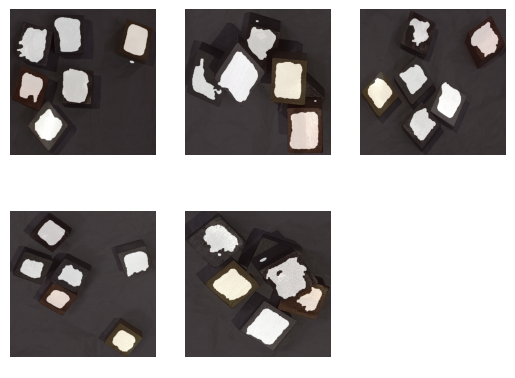

In [ ]:
scaler = torch.amp.GradScaler(device)

def test_model(images, model):
    model.eval()
    B = images.size(0)

    fig, axes = plt.subplots(B // 2, B - (B // 2))
    axes = axes.flatten()

    images = images.to(device)
    outputs = model(images)
    
    for ax in axes:
        ax.axis("off")
    
    for i in range(B):
        with torch.amp.autocast(device):
            prob = torch.sigmoid(outputs[i])
            label = prob.view(1, 480, 480).detach().cpu()
            label = F.avg_pool2d(label, kernel_size=5, stride=1, padding=2)
            label = label.reshape(480, 480)
            label = (label >= 0.35)
            label = label.numpy()
            label = binary_opening(label, structure=np.ones((5,5)))
            label = binary_closing(label, structure=np.ones((5,5)))
            image = images[i].detach().cpu().numpy() # (3, H, W)
            
            if image.max() <= 1.0:
                image = (image * 255).astype(np.uint8)

            image = np.transpose(image, (1, 2, 0)) # (H, W, 3)
            
            axes[i].imshow(image)
            axes[i].imshow(label, cmap="hot", alpha=0.7)
        
    plt.show()

images, _ = next(iter(test_loader))
test_model(images, model)